# Penalty Comparison: fidelity vs sensitivity as a function of λ (sensitivity weight)

This notebook compares the effectiveness of the toggling-frame robustness objective for both multiplicative and additive errors. It's strucuted as follows:
* Imports
* Problem Setups: Here we compare the effect of the toggling frame robustness objective on additive and multiplicative errors without any variational states.
    * Base case: unitary smooth pulse problem w/o any robustness or sentivity objectives
    * Adjoint: Optimize pulses for insenstivity to a) additive error, b) multiplcative error and c) both
    * Toggle Robustness: Optimize pulses for toggle-frame robustness to a - c above
    * Adjoint * Toggle: Both for a - c
* Plot Fidelity vs. Error
* Plot Trajectories and Control pulses
* Pareto Frontiers of Fidelity vs. Robustness Penality

## Imports

In [4]:
import Pkg; Pkg.activate(@__DIR__); Pkg.instantiate();
Pkg.develop(path="../../QuantumCollocation.jl")
using PiccoloQuantumObjects
using QuantumCollocation
using ForwardDiff
using LinearAlgebra
using Plots
using SparseArrays
using Statistics
using CairoMakie
using NamedTrajectories
using TrajectoryIndexingUtils
using Random

  Activating project at `~/Documents/research/pulses/project/notebooks/src`
   Resolving package versions...
  No Changes to `~/Documents/research/pulses/project/notebooks/src/Project.toml`
  No Changes to `~/Documents/research/pulses/project/notebooks/src/Manifest.toml`


## Problem Setups
Here, we first setup the quantum systems and solve for optimal pulses. There are ten problems to solve in total (the default smooth unitary pulse case, and for adjoint only, robustness only, adjoint + robustness, there are 3 cases (additive error, mujltiplcative error, both) giving nine problems).

#### Preliminary Variables

In [9]:
# Problem parameters
T = 20
Δt = 0.5
U_goal = GATES.X
H_drive = [PAULIS.X, PAULIS.Y]
rob_scale = 1 / 8.0
a_bound = 0.2
dda_bound = 0.1
piccolo_opts = PiccoloOptions(verbose=false)
da_bound=Inf
sys = QuantumSystem(H_drive)



QuantumSystem: levels = 2, n_drives = 2

#### Quanutm System Setup 

In [8]:
# Default Template
# H = aX
sys = QuantumSystem(H_drive)

# additive error template
# H = aX
# H_var = X
# ∂ₑHₐ = PAULIS.X

# # Identitcal alternative defintion
# varsys_add = VariationalQuantumSystem(
#     a -> a[1] * PAULIS.X,
#     Function[a -> PAULIS.X],
#     1
# )

# varsys_add = VariationalQuantumSystem(
#     [H_drive],
#     [∂ₑHₐ]
# )

# Multiplicative error template
# H = aX
# H_drive_m = a -> a[1] * H_drive
# H_vars_array = Function[H_drive_m]

# varsys_mult = VariationalQuantumSystem(
#     H_drive_m,
#     H_vars_array,
#     1
# )

# varsys_mult = VariationalQuantumSystem(
#     a -> a[1] * PAULIS.X,
#     Function[a -> a[1] * PAULIS.X],
#     1
# )

# Combine both errors template
# H = aX
# H_var = [aX + X, 0]

# H_drive_b = a -> a[1] * H_drive
# H_vars_array = Function[a -> a[1] * H_drive + PAULIS.X]

# varsys_both = VariationalQuantumSystem(
#     H_drive_b,
#     H_vars_array,
#     1
# )

# varsys_both = VariationalQuantumSystem(
#     a -> a[1] * PAULIS.X,
#     Function[a -> a[1] * PAULIS.X, a -> PAULIS.X],
#     1
# )

println(varsys_add.n_drives)
println(varsys_mult.n_drives)
println(varsys_both.n_drives)

QuantumSystem: levels = 2, n_drives = 2

In [14]:
∂ₑHₐ = PAULIS.X
varsys_add = VariationalQuantumSystem(
    H_drive,
    [∂ₑHₐ]
)

varsys_mult = VariationalQuantumSystem(
    a -> a[1] * PAULIS.X + a[2] * PAULIS.Y,
    Function[a -> a[1] * PAULIS.X],
    2
)

varsys_both = VariationalQuantumSystem(
    a -> a[1] * PAULIS.X + a[2] * PAULIS.Y,
    Function[a -> a[1] * PAULIS.X, a -> PAULIS.X],
    2
)

VariationalQuantumSystem: levels = 2, n_drives = 2

Sanity check

In [ ]:
default = UnitarySmoothPulseProblem(sys, U_goal, T, Δt; a_bound = a_bound, dda_bound = dda_bound)
solve!(default, max_iter=150, print_level=5)
scale = 1.0
add_var_prob = UnitaryVariationalProblem(
        varsys_add, U_goal, T, Δt;
        a_bound = a_bound,
        dda_bound=1.0,
        piccolo_options=piccolo_opts
    )
solve!(add_var_prob, max_iter=150, print_level=5)

mult_var_prob = UnitaryVariationalProblem(
        varsys_mult, U_goal, T, Δt;
        a_bound = a_bound,
        dda_bound = dda_bound,
        piccolo_options=piccolo_opts
    )
solve!(mult_var_prob, max_iter=150, print_level=5)

both_var_prob = UnitaryVariationalProblem(
        varsys_both, U_goal, T, Δt;
        a_bound = a_bound,
        dda_bound = dda_bound,
        piccolo_options=piccolo_opts
    )
solve!(both_var_prob, max_iter=150, print_level=5)

    constructing UnitarySmoothPulseProblem...
	using integrator: typeof(UnitaryIntegrator)
	control derivative names: [:da, :dda]
	applying timesteps_all_equal constraint: Δt
    initializing optimizer...
        applying constraint: timesteps all equal constraint
        applying constraint: initial value of Ũ⃗
        applying constraint: initial value of a
        applying constraint: final value of a
        applying constraint: bounds on a
        applying constraint: bounds on da
        applying constraint: bounds on dda
        applying constraint: bounds on Δt
This is Ipopt version 3.14.17, running with linear solver MUMPS 5.8.0.

Number of nonzeros in equality constraint Jacobian...:     2082
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     1089

Total number of variables............................:      288
                     variables with only lower bounds:        0
                variables with 

In [ ]:
H_drive_add = H_drive

f = Figure()
ax1 = Axis(f[1, 1], title="additive")
ax2 = Axis(f[2, 1], title="multiplicative")

colors = Makie.wong_colors()

εs = -0.02:0.001:0.02
εsa = 0.0:0.00001:0.005

# default case (smooth, non-variational, w/o toggling obj)

ys = [unitary_rollout_fidelity(default.trajectory, QuantumSystem(ε * PAULIS.X, [PAULIS.X])) for ε in εsa]
lines!(ax1, εsa, ys, label="default", color=colors[1], linestyle=:solid)

ys = [unitary_rollout_fidelity(default.trajectory, QuantumSystem([(1 + ε) * PAULIS.X])) for ε in εs]
lines!(ax2, εs, ys, label="default", color=colors[1], linestyle=:solid)

# adjoint-only (no toggling obj)

# (mult)
ys = [unitary_rollout_fidelity(mult_prob.trajectory, QuantumSystem(ε * PAULIS.X, [PAULIS.X])) for ε in εsa]
lines!(ax1, εsa, ys, label="mult adjoint", color=colors[2], linestyle=:solid)

ys = [unitary_rollout_fidelity(mult_prob.trajectory, QuantumSystem([(1 + ε) * PAULIS.X])) for ε in εs]
lines!(ax2, εs, ys, label="mult adjoint", color=colors[2], linestyle=:solid)

# (add)
ys = [unitary_rollout_fidelity(add_prob.trajectory, QuantumSystem(ε * PAULIS.X, [PAULIS.X])) for ε in εsa]
lines!(ax1, εsa, ys, label="add adjoint", color=colors[3], linestyle=:solid)

ys = [unitary_rollout_fidelity(add_prob.trajectory, QuantumSystem([(1 + ε) * PAULIS.X])) for ε in εs]
lines!(ax2, εs, ys, label="add adjoint", color=colors[3], linestyle=:solid)

# (both)
ys = [unitary_rollout_fidelity(both_prob.trajectory, QuantumSystem(ε * PAULIS.X, [PAULIS.X])) for ε in εsa]
lines!(ax1, εsa, ys, label="both adjoint", color=colors[4], linestyle=:solid)

ys = [unitary_rollout_fidelity(both_prob.trajectory, QuantumSystem([(1 + ε) * PAULIS.X])) for ε in εs]
lines!(ax2, εs, ys, label="both adjoint", color=colors[4], linestyle=:solid)



Legend(f[1,2], ax1, position=:lb)
Legend(f[2,2], ax2, position=:lb)

f


#### For adjoint case

In [10]:
n_guesses = 1
a_guess = [0.1*randn(1, T) for _ in 1:n_guesses]
a_bounds = fill(a_bound, 1)
da_bounds = fill(da_bound, 1)
dda_bounds = fill(dda_bound, 1)
control_bounds = (a_bounds, da_bounds, dda_bounds)
varsys_add_seeds = []
varsys_mult_seeds = []
varsys_both_seeds = []

n_drives = varsys_add.n_drives

for i in 1:n_guesses
    add_traj = initialize_trajectory(
                    U_goal,
                    T,
                    Δt,
                    n_drives,
                    control_bounds;
                    a_guess=deepcopy(a_guess[i]),
                    system=varsys_add
                )

    push!(varsys_add_seeds, add_traj)

    mult_traj = initialize_trajectory(
                U_goal,
                T,
                Δt,
                n_drives,
                control_bounds;
                a_guess=deepcopy(a_guess[i]),
                system=varsys_mult
            )

    push!(varsys_mult_seeds, mult_traj)

    both_traj = initialize_trajectory(
                U_goal,
                T,
                Δt,
                n_drives,
                control_bounds;
                a_guess=deepcopy(a_guess[i]),
                system=varsys_both
            )
            
    push!(varsys_both_seeds, both_traj)
end

Run all seeds for various weights (lambdas) using the adjoint objective on only the additive error problem

In [13]:
sweep_rob_loss_λ = [λ for λ in 0:25:75]
n_seeds = n_guesses
n_lambdas = length(sweep_rob_loss_λ)
add_adj_probs = Matrix{Any}(undef, n_seeds, n_lambdas)

for i in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        
        # Add problem
        add_prob = UnitaryVariationalProblem(
            varsys_add, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_add_seeds[i]),
            piccolo_options=piccolo_opts,
        )
        solve!(add_prob; max_iter=125, print_level=5)
        add_adj_probs[i, λ_idx] = add_prob
    end
end

    initializing optimizer...
        applying constraint: timesteps all equal constraint
        applying constraint: initial value of Ũ⃗
        applying constraint: initial value of a
        applying constraint: initial value of Ũ⃗ᵥ1
        applying constraint: final value of a
        applying constraint: bounds on a
        applying constraint: bounds on da
        applying constraint: bounds on dda
        applying constraint: bounds on Δt
This is Ipopt version 3.14.17, running with linear solver MUMPS 5.8.0.

Number of nonzeros in equality constraint Jacobian...:     5692
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:      679

Total number of variables............................:      382
                     variables with only lower bounds:        0
                variables with lower and upper bounds:       58
                     variables with only upper bounds:        0
Total number of equality co

Plot the corresponding fidelity as a function of epsilon (error magnitude)

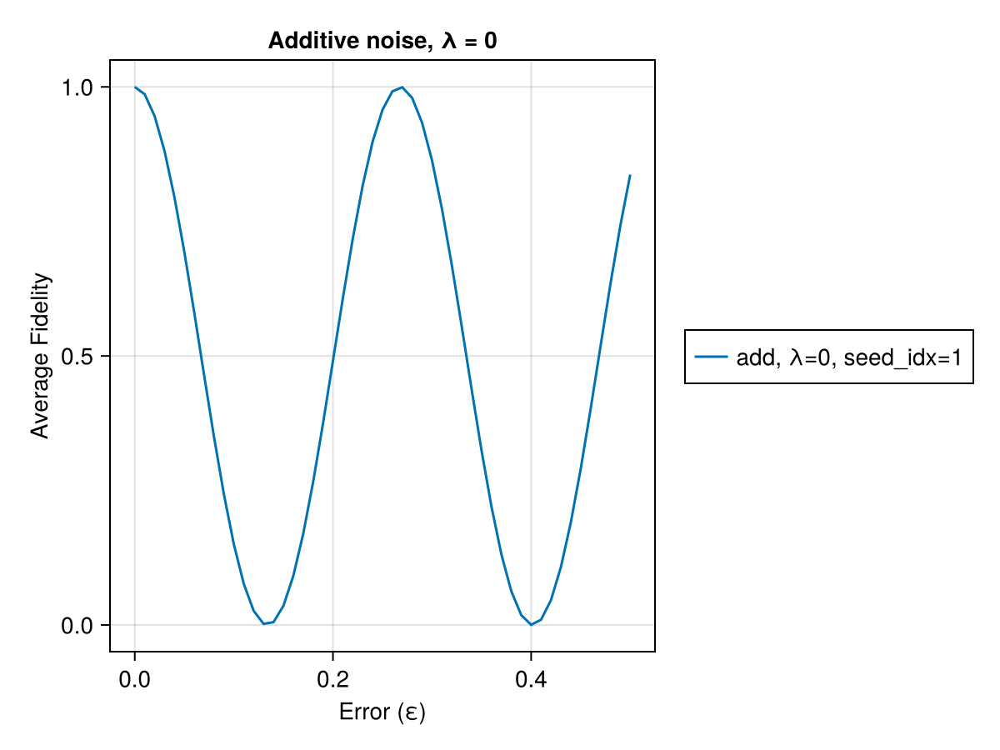


Processing λ = 0

Processing λ = 25

Processing λ = 50

Processing λ = 75


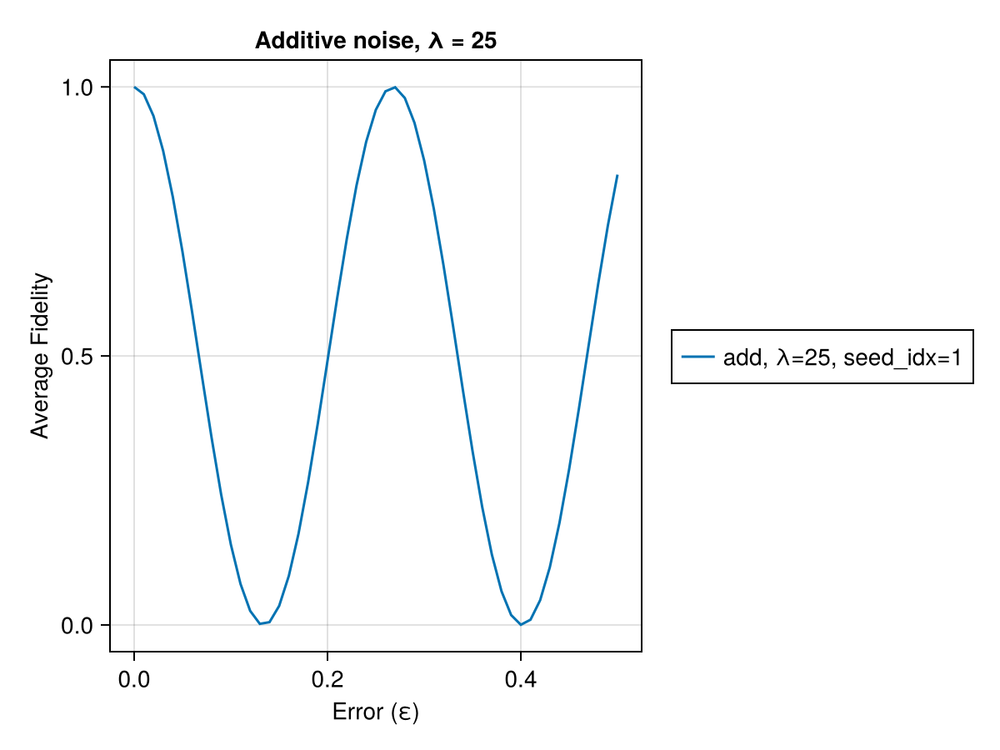

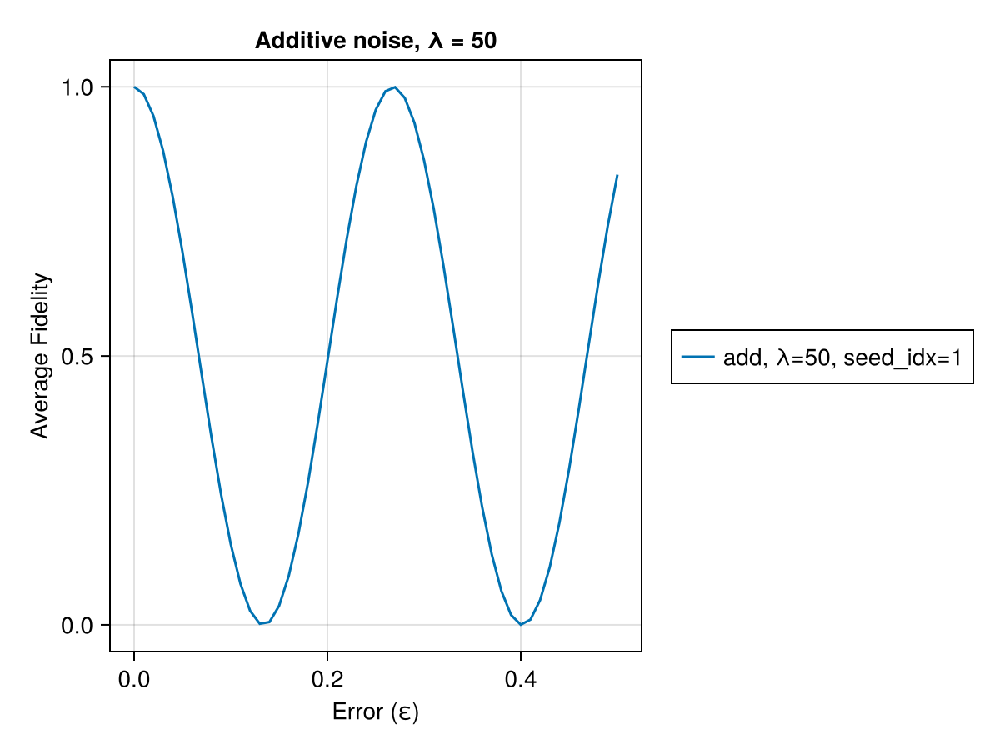

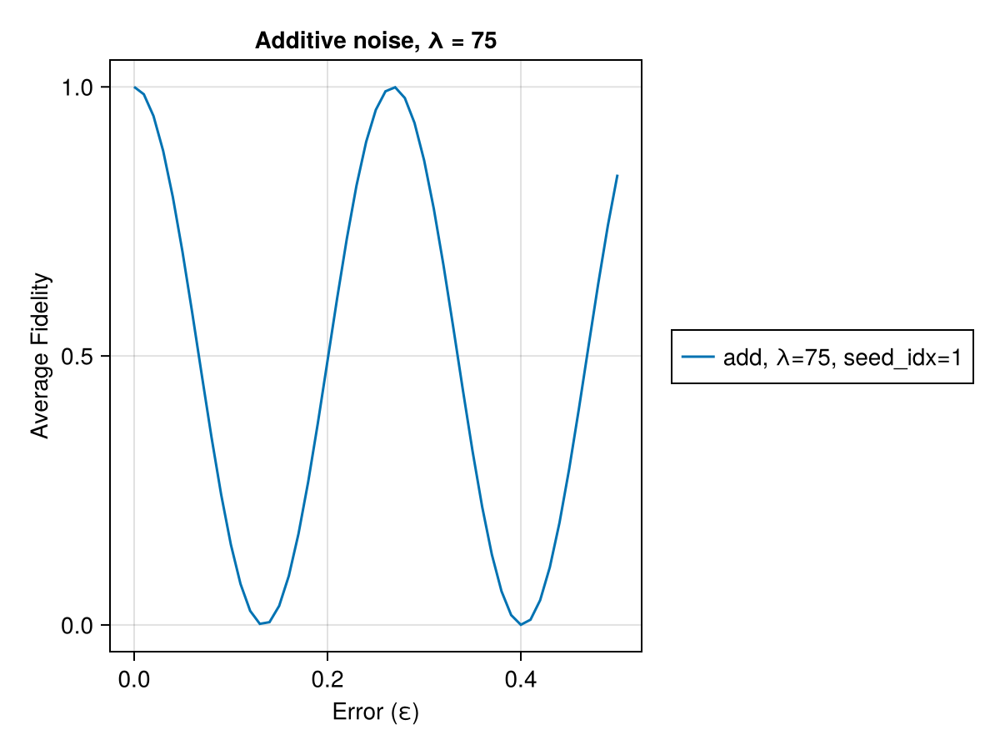

In [14]:
H_drive_add = H_drive
εs = 0:0.01:0.5
colors = Makie.wong_colors()

for seed_idx in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        println("\nProcessing λ = $λ")
        f = Figure()
        ax1 = Axis(f[1, 1], title="Additive noise, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")

        # Define system functions for additive and multiplicative noise
        additive_system = ε -> QuantumSystem(ε * PAULIS.X, [H_drive_add])
        multiplicative_system = ε -> QuantumSystem([(1 + ε) * H_drive])

        # Plot for both noise types
        # Additive noise
        ys_add = [unitary_rollout_fidelity(add_adj_probs[seed_idx, λ_idx].trajectory, additive_system(ε)) for ε in εs]
        lines!(ax1, εs, ys_add, label="add, λ=$λ, seed_idx=$seed_idx", color=colors[1], linestyle=:solid)

        # Add legends
        Legend(f[1, 2], ax1, position=:lb)
        
        display(f)
    end
end


setup the same problems for the default, multiplcative, both error cases

In [76]:
default_probs = Matrix{Any}(undef, n_seeds, n_lambdas)

for i in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        defaults = UnitarySmoothPulseProblem(sys, U_goal, T, Δt; a_guess=deepcopy(a_guess[i]))
        solve!(default; max_iter=750, print_level=5)
        default_probs[i,λ_idx] = defaults
    end
end

In [78]:
mult_adj_probs = Matrix{Any}(undef, n_seeds, n_lambdas)
for i in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        # Mult problem
        mult_prob = UnitaryVariationalProblem(
            varsys_mult, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_mult_seeds[i]),
            variational_scales=[rob_scale],
            sensitive_times=[[T]], 
            piccolo_options=piccolo_opts,
            Q_s=λ
        )
        solve!(mult_prob; max_iter=200, print_level=5)
        mult_adj_probs[i, λ_idx] = mult_prob
    end
end

In [74]:
both_adj_probs = Matrix{Any}(undef, n_seeds, n_lambdas)

# Optimization loop with index counter
for i in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        
        # Both problem
        both_prob = UnitaryVariationalProblem(
            varsys_both, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_both_seeds[i]),
            variational_scales=[rob_scale,rob_scale],
            sensitive_times=[[T]],
            piccolo_options=piccolo_opts,
            Q_s=λ
        )
        solve!(both_prob; max_iter=200, print_level=5)
        both_adj_probs[i, λ_idx] = both_prob
    end
end

CompositeException: TaskFailedException

    nested task error: InterruptException:
    Stacktrace:
      [1] primal_value(x::Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}})
        @ AbstractDifferentiation ~/.julia/packages/AbstractDifferentiation/pjgzv/src/forwarddiff.jl:42
      [2] _opnormInf
        @ ~/.julia/packages/ExponentialAction/I5nOJ/src/util.jl:3 [inlined]
      [3] expv_taylor(t::ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, A::SparseMatrixCSC{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, Int64}, B::Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, degree_max::Int64; tol::Float64)
        @ ExponentialAction ~/.julia/packages/ExponentialAction/I5nOJ/src/taylor.jl:25
      [4] expv_taylor
        @ ~/.julia/packages/ExponentialAction/I5nOJ/src/taylor.jl:18 [inlined]
      [5] _expv_core(Δt::ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, A::SparseMatrixCSC{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, Int64}, B::SubArray{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, 1, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, Tuple{Vector{Int64}}, false}, degree_opt::Int64, μ::ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, num_steps::Int64, tol::Float64)
        @ ExponentialAction ~/.julia/packages/ExponentialAction/I5nOJ/src/expv.jl:47
      [6] expv(t::ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, A::SparseMatrixCSC{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, Int64}, B::SubArray{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, 1, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, Tuple{Vector{Int64}}, false}; shift::Bool, tol::Float64)
        @ ExponentialAction ~/.julia/packages/ExponentialAction/I5nOJ/src/expv.jl:38
      [7] expv
        @ ~/.julia/packages/ExponentialAction/I5nOJ/src/expv.jl:35 [inlined]
      [8] (::BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}})(δₖ::Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, zₖ::SubArray{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, 1, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, Tuple{UnitRange{Int64}}, true}, zₖ₊₁::SubArray{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}, 1, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, Tuple{UnitRange{Int64}}, true})
        @ DirectTrajOpt.Integrators ~/.julia/packages/DirectTrajOpt/7J4T8/src/integrators/bilinear_integrator.jl:154
      [9] (::DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}})(zz::Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}})
        @ DirectTrajOpt.Integrators ~/.julia/packages/DirectTrajOpt/7J4T8/src/integrators/bilinear_integrator.jl:65
     [10] chunk_mode_gradient(f::DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, x::Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}}, cfg::ForwardDiff.GradientConfig{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}})
        @ ForwardDiff ~/.julia/packages/ForwardDiff/Wq9Wb/src/gradient.jl:132
     [11] gradient
        @ ~/.julia/packages/ForwardDiff/Wq9Wb/src/gradient.jl:22 [inlined]
     [12] #107
        @ ~/.julia/packages/ForwardDiff/Wq9Wb/src/hessian.jl:17 [inlined]
     [13] chunk_mode_jacobian(f::ForwardDiff.var"#107#108"{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, ForwardDiff.HessianConfig{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}}}}, x::Vector{Float64}, cfg::ForwardDiff.JacobianConfig{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}}})
        @ ForwardDiff ~/.julia/packages/ForwardDiff/Wq9Wb/src/jacobian.jl:198
     [14] jacobian
        @ ~/.julia/packages/ForwardDiff/Wq9Wb/src/jacobian.jl:24 [inlined]
     [15] hessian
        @ ~/.julia/packages/ForwardDiff/Wq9Wb/src/hessian.jl:18 [inlined]
     [16] hessian(f::DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, x::Vector{Float64}, cfg::ForwardDiff.HessianConfig{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}, 12}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, Float64}, Float64, 12}}})
        @ ForwardDiff ~/.julia/packages/ForwardDiff/Wq9Wb/src/hessian.jl:15
     [17] hessian(f::DirectTrajOpt.Integrators.var"#3#4"{BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}}, x::Vector{Float64})
        @ ForwardDiff ~/.julia/packages/ForwardDiff/Wq9Wb/src/hessian.jl:15
     [18] hessian_of_lagrangian
        @ ~/.julia/packages/DirectTrajOpt/7J4T8/src/integrators/bilinear_integrator.jl:62 [inlined]
     [19] macro expansion
        @ ~/.julia/packages/DirectTrajOpt/7J4T8/src/dynamics.jl:172 [inlined]
     [20] (::DirectTrajOpt.Dynamics.var"#144#threadsfor_fun#17"{DirectTrajOpt.Dynamics.var"#144#threadsfor_fun#5#18"{Vector{SparseMatrixCSC{Float64, Int64}}, Vector{Float64}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}, UnitRange{Int64}, BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, UnitRange{Int64}, NamedTrajectory{Float64, (:Ũ⃗, :a, :da, :dda, :Δt, :Ũ⃗ᵥ1, :Ũ⃗ᵥ2), NTuple{7, Int64}, (:a, :da, :dda, :Δt), NTuple{4, Tuple{Vector{Float64}, Vector{Float64}}}, (:Ũ⃗, :a, :Ũ⃗ᵥ1, :Ũ⃗ᵥ2), NTuple{4, Vector{Float64}}, (:a,), Tuple{Vector{Float64}}, (:Ũ⃗,), Tuple{Vector{Float64}}, (:Ũ⃗, :a, :da, :dda, :Δt, :Ũ⃗ᵥ1, :Ũ⃗ᵥ2), NTuple{7, UnitRange{Int64}}, NTuple{7, Symbol}, NTuple{5, Symbol}, Tuple{Symbol, Symbol}, (), Tuple{}, (), Tuple{}, Tuple{}}, Int64}})(tid::Int64; onethread::Bool)
        @ DirectTrajOpt.Dynamics ./threadingconstructs.jl:253
     [21] #144#threadsfor_fun
        @ ./threadingconstructs.jl:220 [inlined]
     [22] (::Base.Threads.var"#1#2"{DirectTrajOpt.Dynamics.var"#144#threadsfor_fun#17"{DirectTrajOpt.Dynamics.var"#144#threadsfor_fun#5#18"{Vector{SparseMatrixCSC{Float64, Int64}}, Vector{Float64}, SubArray{Float64, 1, Vector{Float64}, Tuple{UnitRange{Int64}}, true}, UnitRange{Int64}, BilinearIntegrator{QuantumCollocation.QuantumIntegrators.var"#Ĝ#9"{Vector{Float64}, VariationalQuantumSystem{var"#81#84", PiccoloQuantumObjects.QuantumSystems.var"#54#65"{var"#81#84"}, Vector{Function}}}}, UnitRange{Int64}, NamedTrajectory{Float64, (:Ũ⃗, :a, :da, :dda, :Δt, :Ũ⃗ᵥ1, :Ũ⃗ᵥ2), NTuple{7, Int64}, (:a, :da, :dda, :Δt), NTuple{4, Tuple{Vector{Float64}, Vector{Float64}}}, (:Ũ⃗, :a, :Ũ⃗ᵥ1, :Ũ⃗ᵥ2), NTuple{4, Vector{Float64}}, (:a,), Tuple{Vector{Float64}}, (:Ũ⃗,), Tuple{Vector{Float64}}, (:Ũ⃗, :a, :da, :dda, :Δt, :Ũ⃗ᵥ1, :Ũ⃗ᵥ2), NTuple{7, UnitRange{Int64}}, NTuple{7, Symbol}, NTuple{5, Symbol}, Tuple{Symbol, Symbol}, (), Tuple{}, (), Tuple{}, Tuple{}}, Int64}}, Int64})()
        @ Base.Threads ./threadingconstructs.jl:154

plot fid v err magnitude for the above problems

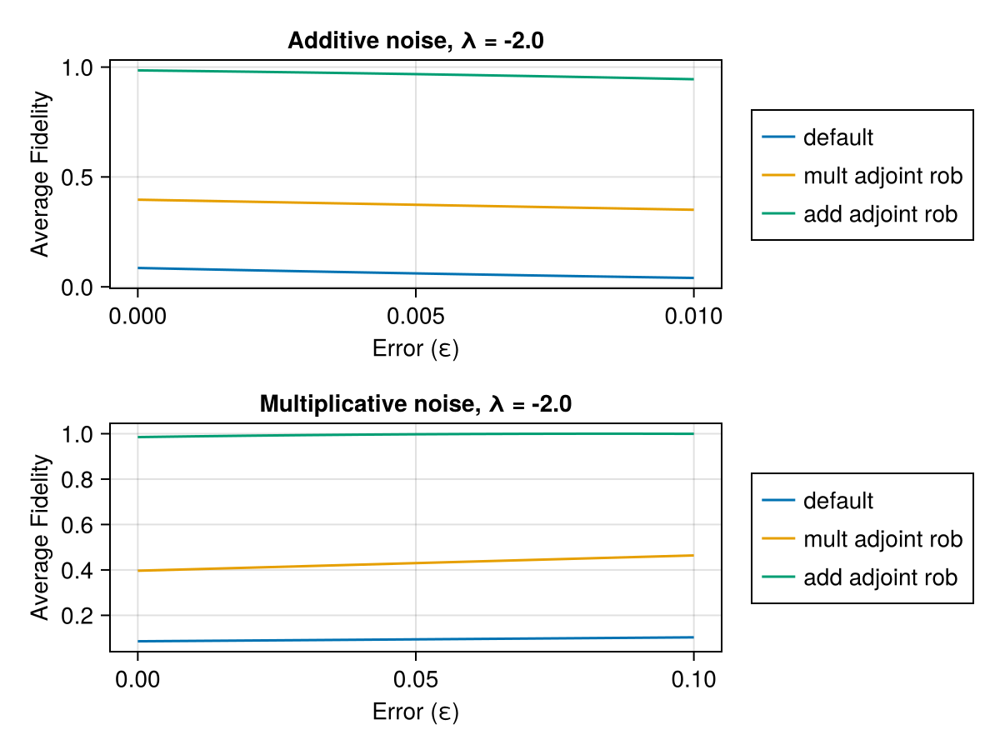

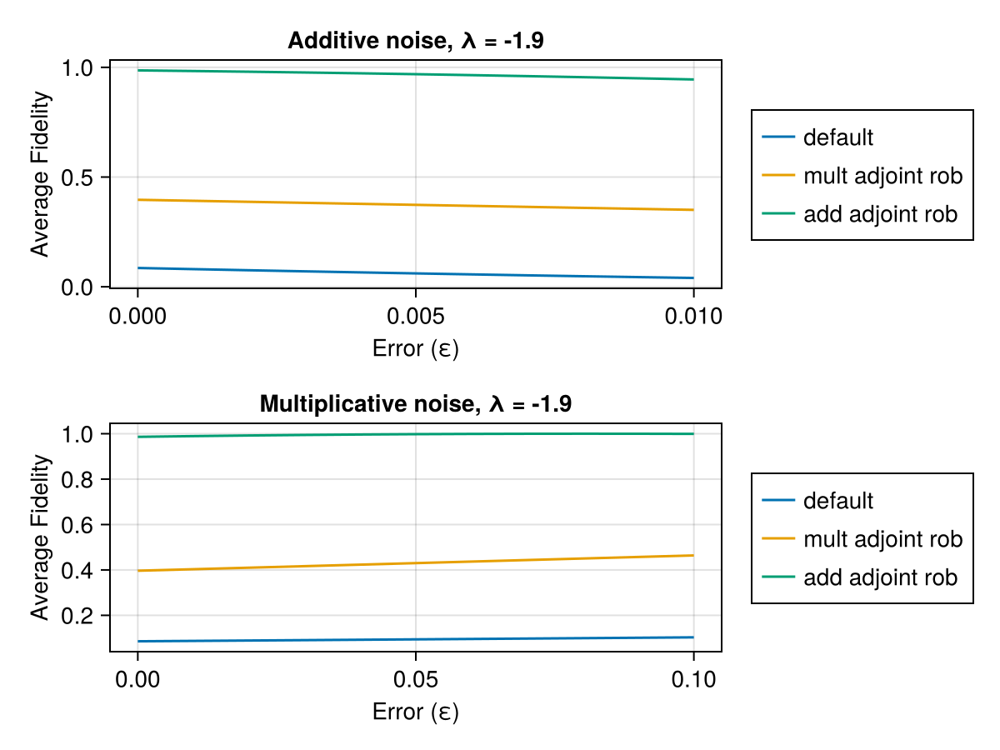

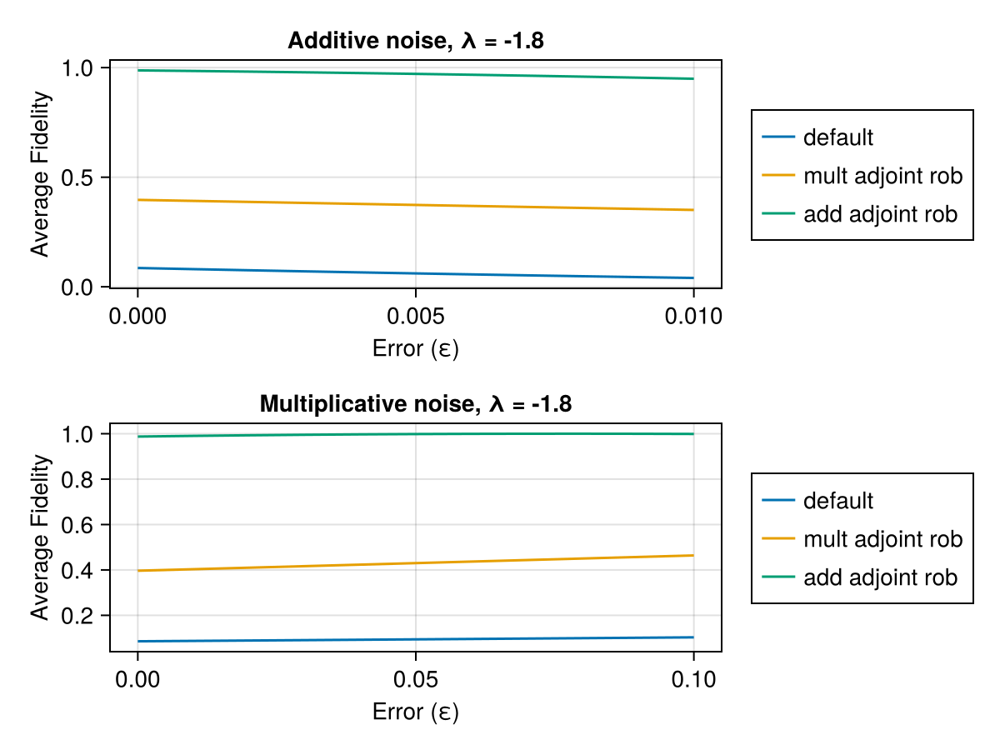

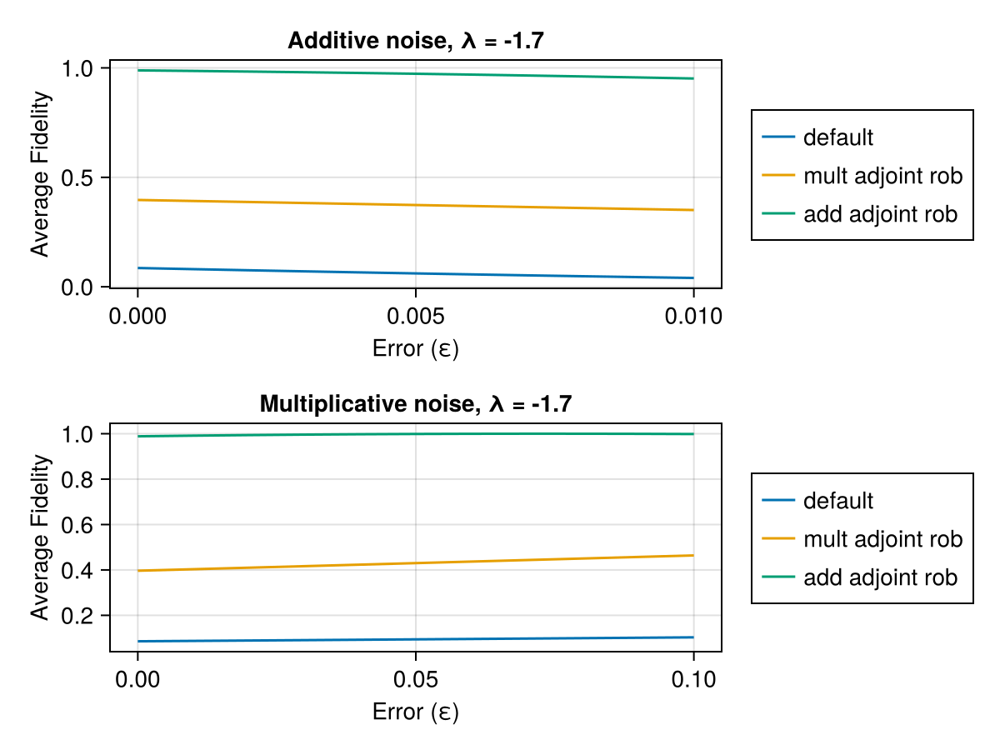

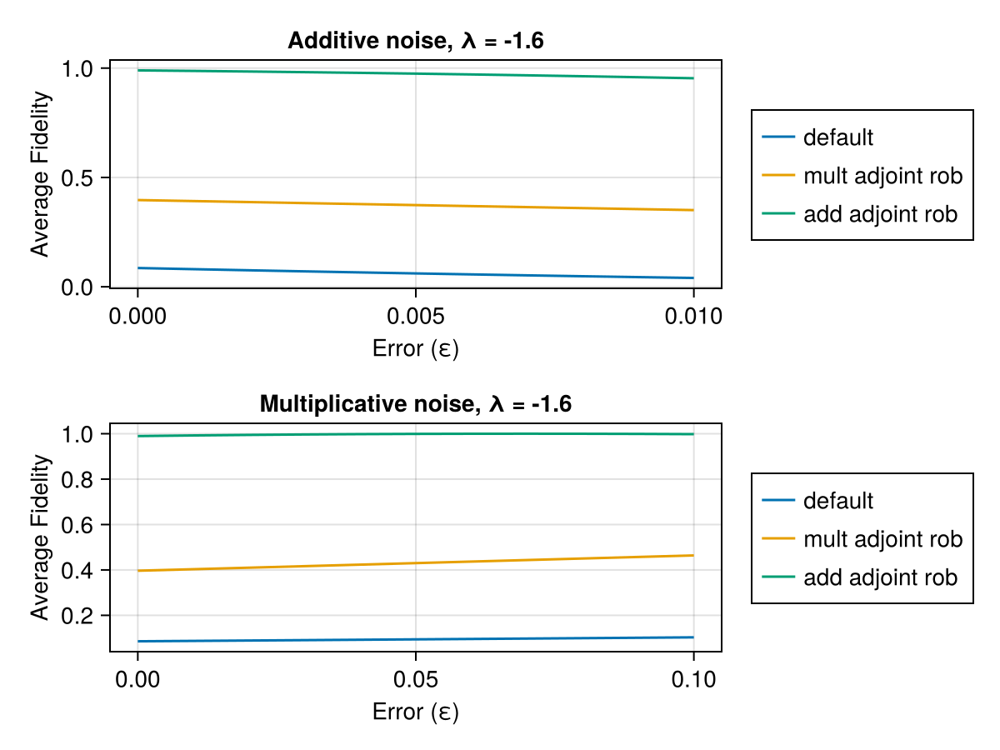

...

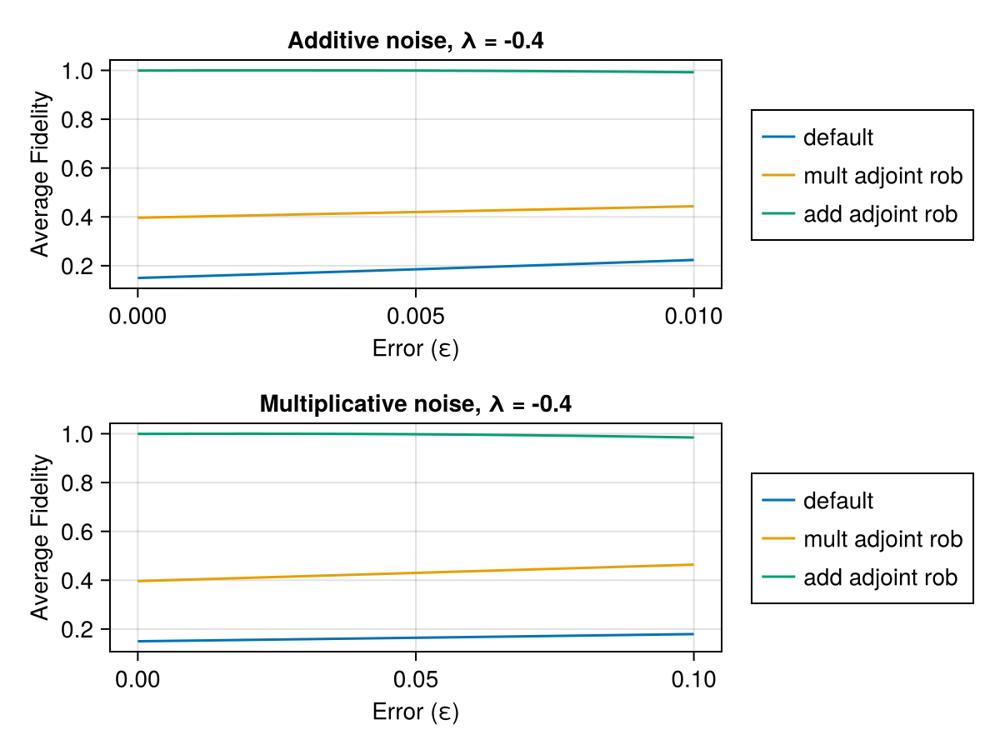

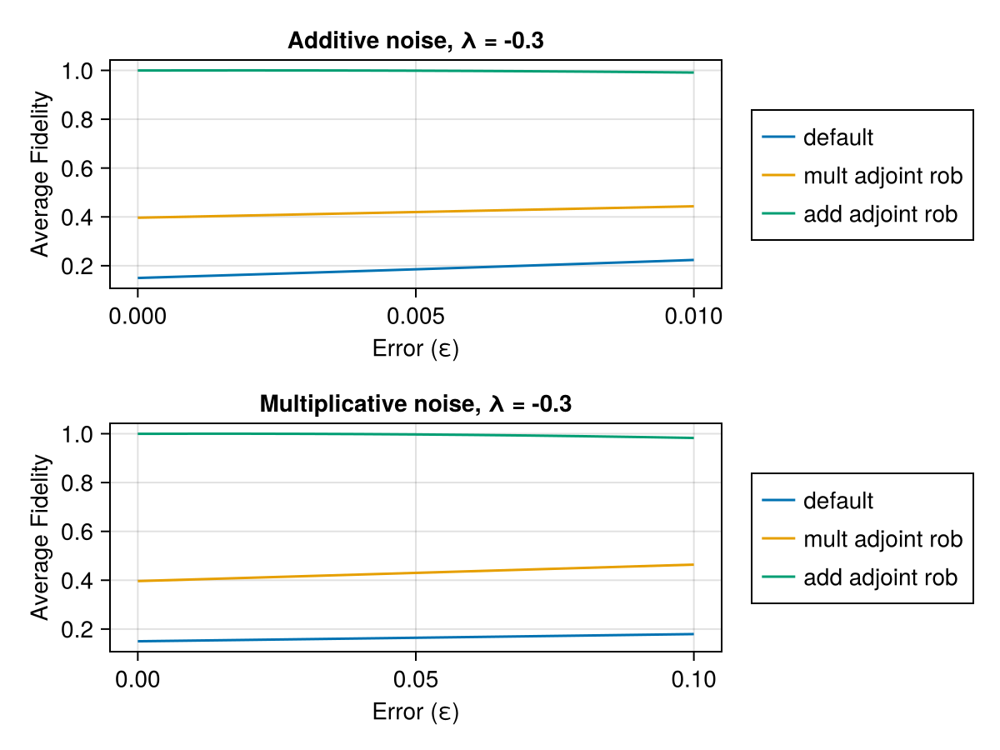

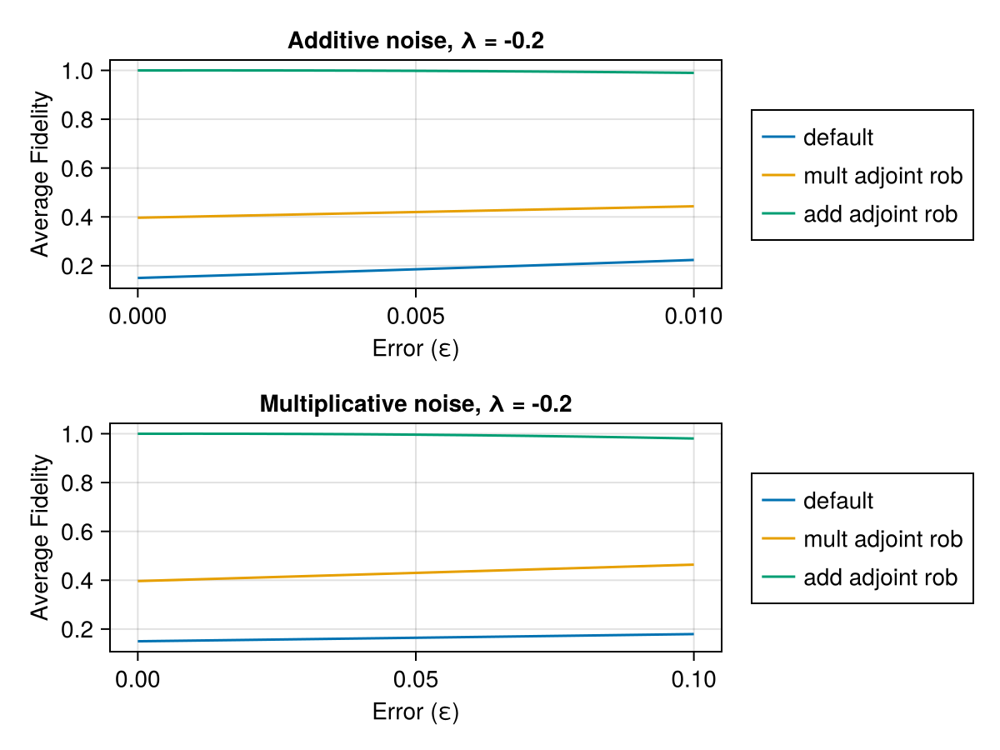

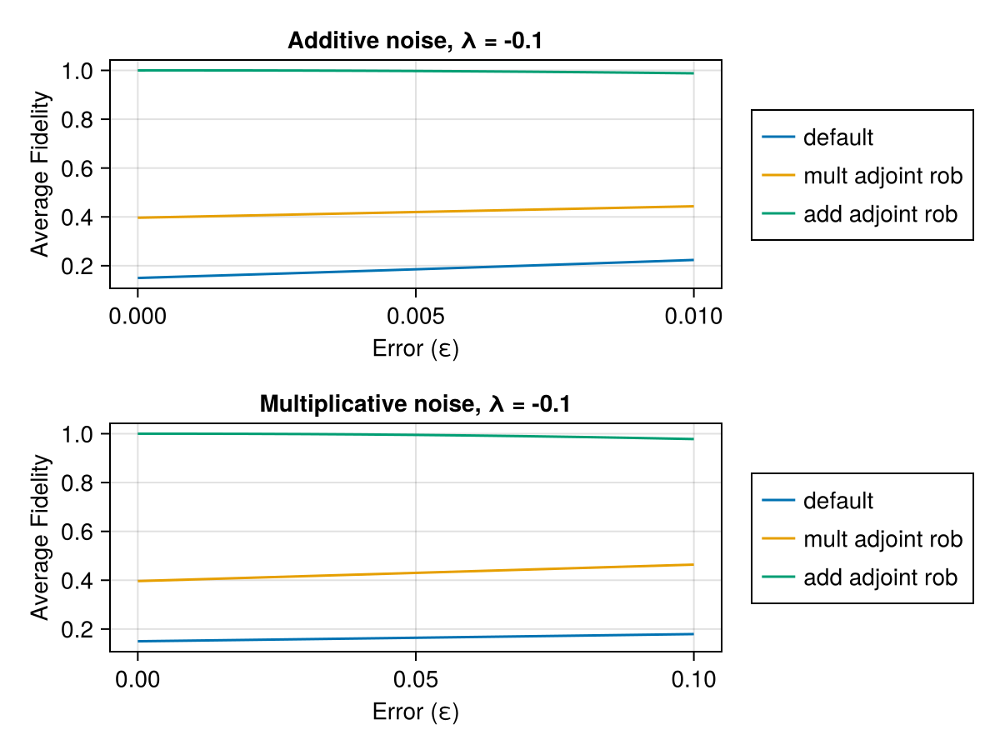

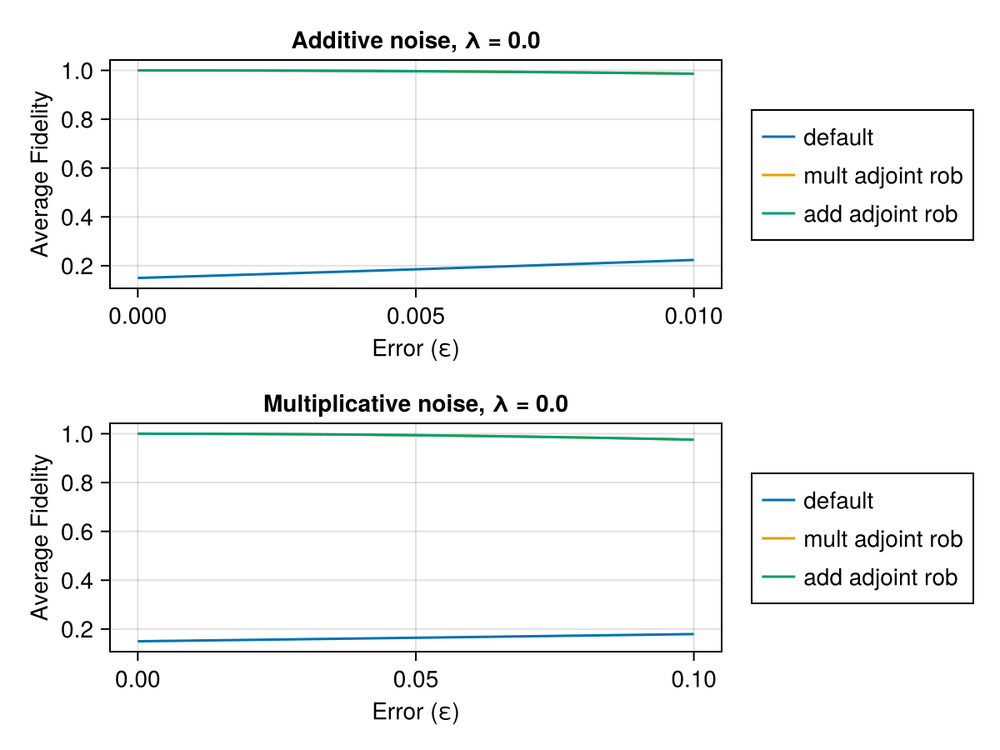

In [79]:
H_drive_add = H_drive
εs = 0:0.01:0.1
colors = Makie.wong_colors()

# Plot for each λ
for seed_idx in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        println("\nProcessing λ = $λ")
        f = Figure()
        ax1 = Axis(f[1, 1], title="Additive noise, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")
        ax2 = Axis(f[2, 1], title="Multiplicative noise, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")
        # ax3 = Axis(f[3, 1], title="Both noises, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")

        # Define system functions for additive and multiplicative noise
        additive_system = ε -> QuantumSystem(ε * PAULIS.X, [H_drive_add])
        multiplicative_system = ε -> QuantumSystem([(1 + ε) * H_drive])
        # both_system = ε -> QuantumSystem(ε * PAULIS.X, [(1 + ε) * H_drive])
        # Plot data structure: (matrix, label, color)
        plot_configs = [
            (default_probs, "default", colors[1]),
            (add_adj_probs, "mult adjoint rob", colors[2]),
            (mult_adj_probs, "add adjoint rob", colors[3])#,
            # (both_adj_probs, "both adjoint rob", colors[4])
        ]

        # Plot for both noise types
        for (probs_matrix, label, color) in plot_configs
            # Additive noise
            prob = probs_matrix[seed_idx, λ_idx]
            ys_add = [unitary_rollout_fidelity(prob.trajectory, QuantumSystem(ε * PAULIS.X, [H_drive_add])) for ε in 0:0.001:0.01]
            lines!(ax1, 0.1*εs, ys_add, label=label, color=color, linestyle=:solid)
            
            # Multiplicative noise
            ys_mult = [unitary_rollout_fidelity(prob.trajectory, QuantumSystem([(1 + ε) * H_drive])) for ε in εs]
            lines!(ax2, εs, ys_mult, label=label, color=color, linestyle=:solid)
            
            # Both noises
            ys_both = [unitary_rollout_fidelity(prob.trajectory, QuantumSystem(ε * PAULIS.X, [(1 + ε) * H_drive])) for ε in 0:0.001:0.01]
            lines!(ax3, 0.1*εs, ys_both, label=label, color=color, linestyle=:solid)
        end

        Legend(f[1, 2], ax1, position=:lb)
        Legend(f[2, 2], ax2, position=:lb)
        # Legend(f[3, 2], ax3, position=:lb)

        display(f)
    end
end


#### Toggling frame

example problem (sanity check)

In [12]:
Hₑ_add = a -> PAULIS.X

ex_tog_default = UnitarySmoothPulseProblem(
    sys, U_goal, T, Δt;
    activate_rob_loss=true,
    H_err=H_drive,
    Q_t=10.0,
    a_guess=deepcopy(a_guess[1]))

solve!(ex_tog_default, max_iter=150, print_level=5)

add_tog_prob = UnitarySmoothPulseProblem(
    sys, U_goal, T, Δt; 
    init_trajectory=deepcopy(add_seeds[i]),
    activate_rob_loss=true,
    H_err=Hₑ_add,
    Q_t=10.0)

solve!(add_tog_prob; max_iter=150, print_level=5)

    constructing UnitarySmoothPulseProblem...
	using integrator: typeof(UnitaryIntegrator)
	control derivative names: [:da, :dda]
	applying timesteps_all_equal constraint: Δt
    initializing optimizer...
        applying constraint: timesteps all equal constraint
        applying constraint: initial value of Ũ⃗
        applying constraint: initial value of a
        applying constraint: final value of a
        applying constraint: bounds on a
        applying constraint: bounds on da
        applying constraint: bounds on dda
        applying constraint: bounds on Δt
This is Ipopt version 3.14.17, running with linear solver MUMPS 5.8.0.

Number of nonzeros in equality constraint Jacobian...:     1788
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:    23783

Total number of variables............................:      230
                     variables with only lower bounds:        0
                variables with 

In [13]:
X_drive = sys.H.H_drives[1]
Hₑ_mult = a -> a[1] * X_drive

ex_mult_prob = UnitarySmoothPulseProblem(
    sys, U_goal, T, Δt;
    init_trajectory=deepcopy(varsys_mult_seeds[1]), 
    piccolo_options=piccolo_opts,
    activate_rob_loss=true,
    H_err=Hₑ_mult,
    Q_t=10.0
)
solve!(ex_mult_prob; max_iter=150, print_level=5)

ex_both_prob = UnitaryVariationalProblem(
            varsys_both, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_both_seeds[1]),
            piccolo_options=piccolo_opts,
            activate_rob_loss=true,
            H_err=Hₑ_mult,
            Q_t=100.0
        )
solve!(ex_both_prob; max_iter=150, print_level=5)

    initializing optimizer...
        applying constraint: timesteps all equal constraint
        applying constraint: initial value of Ũ⃗
        applying constraint: initial value of a
        applying constraint: initial value of Ũ⃗ᵥ1
        applying constraint: final value of a
        applying constraint: bounds on a
        applying constraint: bounds on da
        applying constraint: bounds on dda
        applying constraint: bounds on Δt
This is Ipopt version 3.14.17, running with linear solver MUMPS 5.8.0.

Number of nonzeros in equality constraint Jacobian...:     5692
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:    23847

Total number of variables............................:      382
                     variables with only lower bounds:        0
                variables with lower and upper bounds:       58
                     variables with only upper bounds:        0
Total number of equality co

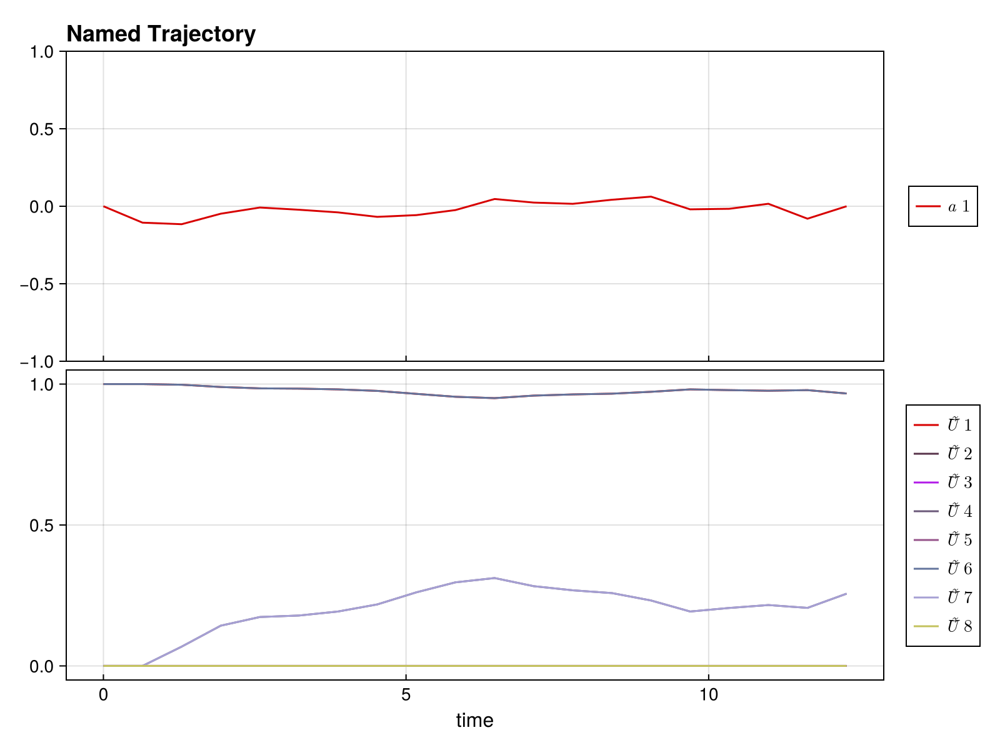

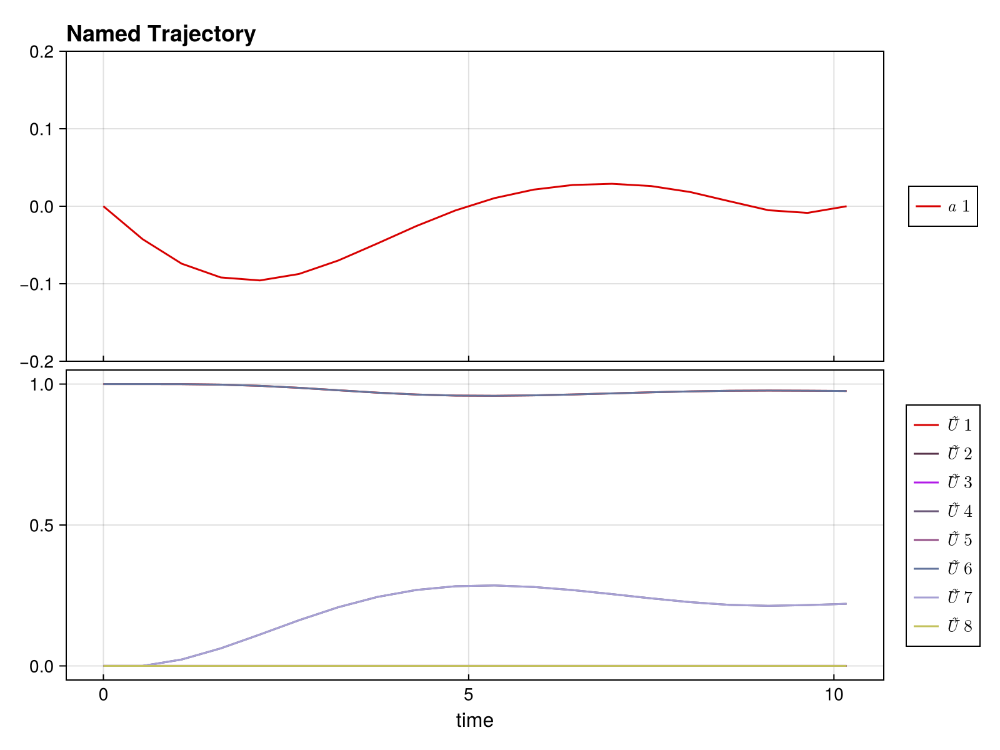

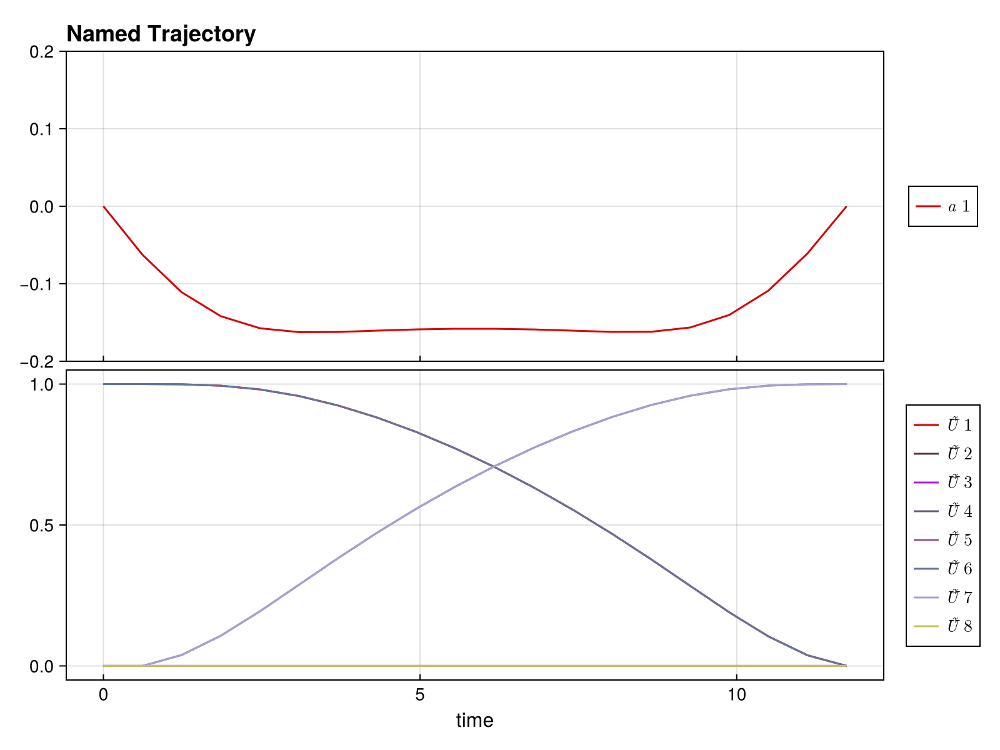

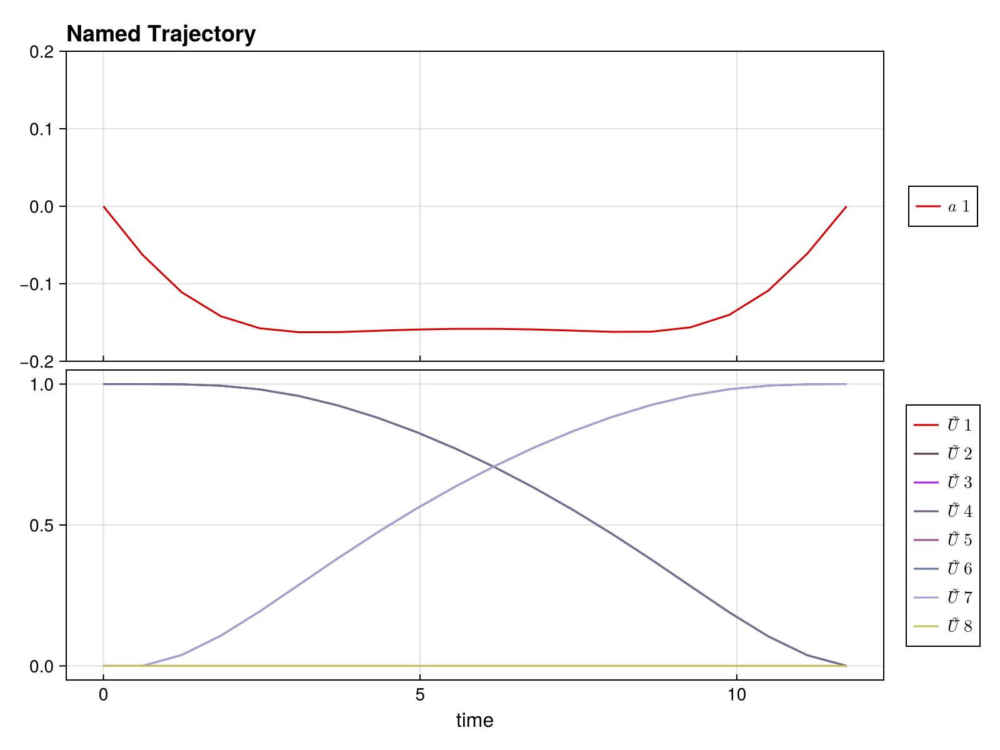

CairoMakie.Screen{IMAGE}


In [9]:
p1 = CairoMakie.plot(ex_tog_default.trajectory, [:a, :Ũ⃗])
p2 = CairoMakie.plot(ex_add_prob.trajectory, [:a, :Ũ⃗])
p3 = CairoMakie.plot(ex_mult_prob.trajectory, [:a, :Ũ⃗])
p4 = CairoMakie.plot(ex_both_prob.trajectory, [:a, :Ũ⃗])

display(p1)
display(p2)
display(p3)
display(p4)

In [14]:
# default case
println("No error default case")
Ũ⃗ = unitary_rollout_fidelity(ex_tog_default.trajectory, sys)
display((QuantumObjectives.unitary_fidelity_loss(Ũ⃗[:, end], GATES.X)))

# additive
println("Additive error case")
Ũ⃗ = unitary_rollout_fidelity(ex_add_prob.trajectory, sys)
display(QuantumObjectives.unitary_fidelity_loss(Ũ⃗_t[:, end], GATES.X))

# mult
println("multiplicative error case")
Ũ⃗ = unitary_rollout_fidelity(ex_mult_prob.trajectory, sys)
display(QuantumObjectives.unitary_fidelity_loss(Ũ⃗[:, end], GATES.X))


# both problem
println("Both additive and multiplicative error case (for additive, multipcative, both systems)")

Ũ⃗ = unitary_rollout_fidelity(ex_both_prob.trajectory, sys)
display(QuantumObjectives.unitary_fidelity_loss(Ũ⃗[:, end], GATES.X))

Ũ⃗ = unitary_rollout_fidelity(ex_both_prob.trajectory, sys);
display(QuantumObjectives.unitary_fidelity_loss(Ũ⃗[:, end], GATES.X))

Ũ⃗ = unitary_rollout_fidelity(ex_both_prob.trajectory, sys);
display(QuantumObjectives.unitary_fidelity_loss(Ũ⃗[:, end], GATES.X))

0.9999996988599309

0.7188034931578401

0.999999991694289

0.7188034931578403

0.7188034931578403

0.7188034931578403

No error default case
Additive error case
multiplicative error case
Both additive and multiplicative error case (for additive, multipcative, both systems)


In [10]:
# define parameters
sweep_rob_loss_λ = [10^i for i in 0:5.0]
n_lambdas = length(sweep_rob_loss_λ)
n_seeds = length(a_guess)

# Initialize storage for results
tog_defaults = Matrix{Any}(undef, n_seeds, n_lambdas)
add_tog_probs = Matrix{Any}(undef, n_seeds, n_lambdas)
mult_tog_probs = Matrix{Any}(undef, n_seeds, n_lambdas)
both_tog_probs = Matrix{Any}(undef, n_seeds, n_lambdas)

# loop through solve!
for i in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)

        tog_default = UnitarySmoothPulseProblem(sys, U_goal, T, Δt; activate_rob_loss=true, H_err=H_drive, Q_t=λ)
        solve!(tog_default, max_iter=150, print_level=5)
        tog_defaults[i, λ_idx] = tog_default
            
        # Additive error case
        add_prob = UnitaryVariationalProblem(
            varsys_add, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_add_seeds[i].trajectory),
            piccolo_options=piccolo_opts,
            activate_rob_loss=true,
            H_err=H_drive,
            Q_s=0.0,
            Q_r=0.0,
            Q_t=λ
        )
        solve!(add_prob; max_iter=150, print_level=5)
        add_tog_probs[i, λ_idx] = add_prob

        # Mult error case
        mult_prob = UnitaryVariationalProblem(
            varsys_mult, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_mult_seeds[i]),
            piccolo_options=piccolo_opts,
            activate_rob_loss=true,
            H_err=H_drive,
            Q_s=0.0,
            Q_r=0.0,
            Q_t=λ
        )
        solve!(mult_prob; max_iter=150, print_level=5)
        mult_tog_probs[i, λ_idx] = mult_prob

        # Both error case
        both_prob = UnitaryVariationalProblem(
            varsys_both, U_goal, T, Δt;
            init_trajectory=deepcopy(varsys_both_seeds[i]),
            piccolo_options=piccolo_opts,
            activate_rob_loss=true,
            H_err=H_drive,
            Q_s=0.0,
            Q_r=0.0,
            Q_t=λ
        )
        solve!(both_prob; max_iter=150, print_level=5)
        both_tog_probs[i, λ_idx] = both_prob
    end
end

    constructing UnitarySmoothPulseProblem...
	using integrator: typeof(UnitaryIntegrator)
	control derivative names: [:da, :dda]
	applying timesteps_all_equal constraint: Δt
    initializing optimizer...
        applying constraint: timesteps all equal constraint
        applying constraint: initial value of Ũ⃗
        applying constraint: initial value of a
        applying constraint: final value of a
        applying constraint: bounds on a
        applying constraint: bounds on da
        applying constraint: bounds on dda
        applying constraint: bounds on Δt

******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.17, runnin

Excessive output truncated after 524349 bytes.

## Plot Fidelity vs. Errors

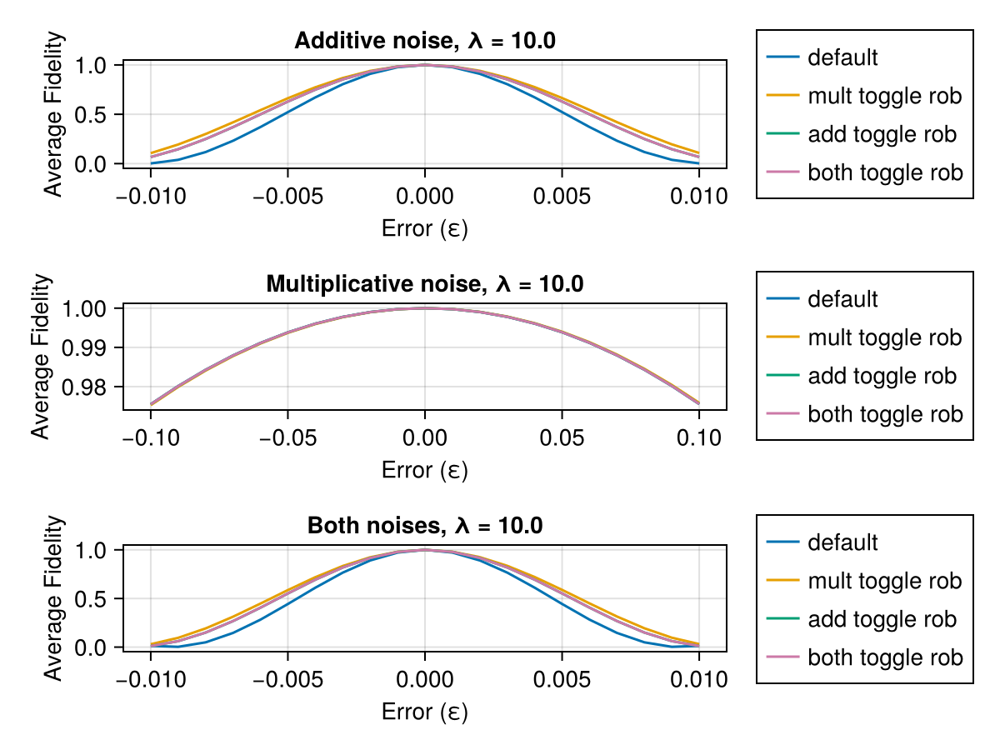

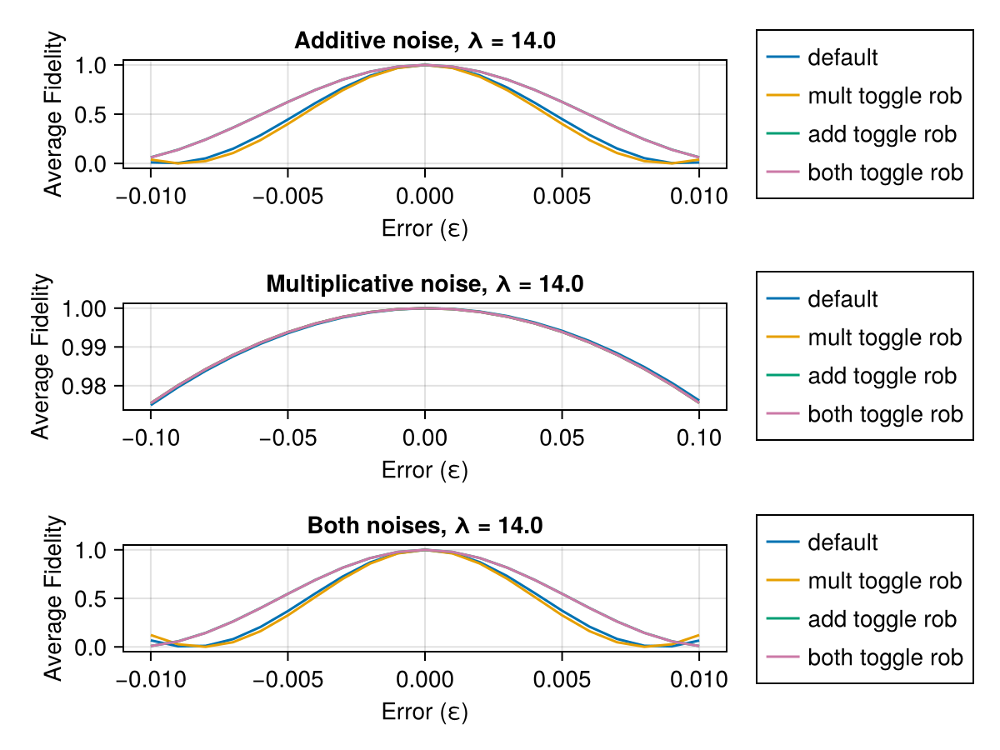

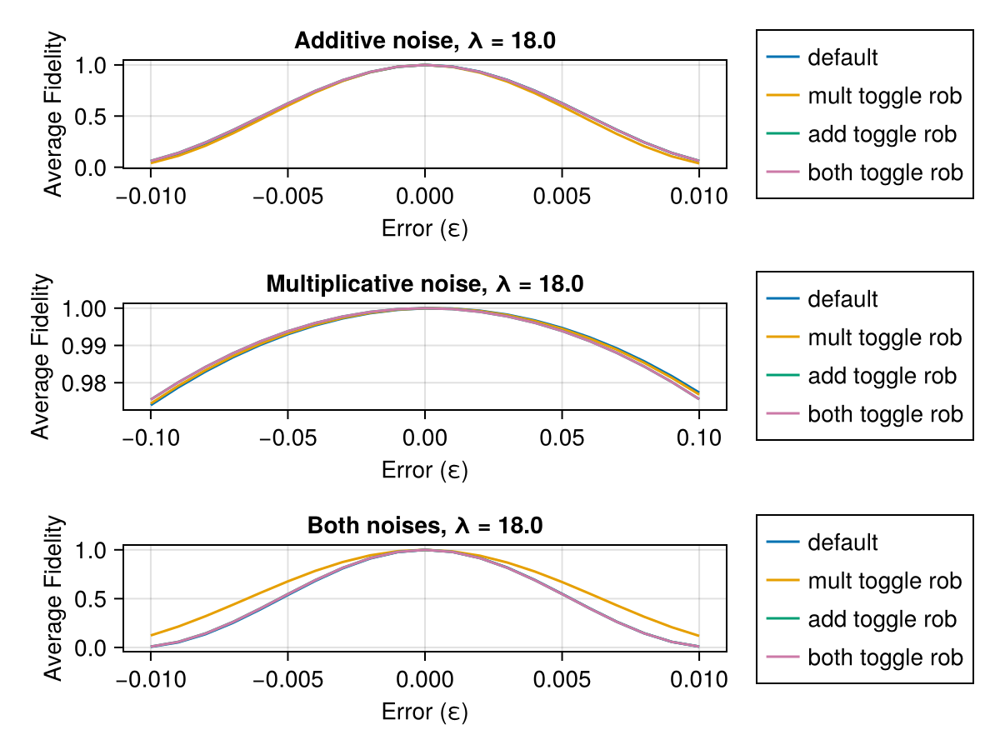

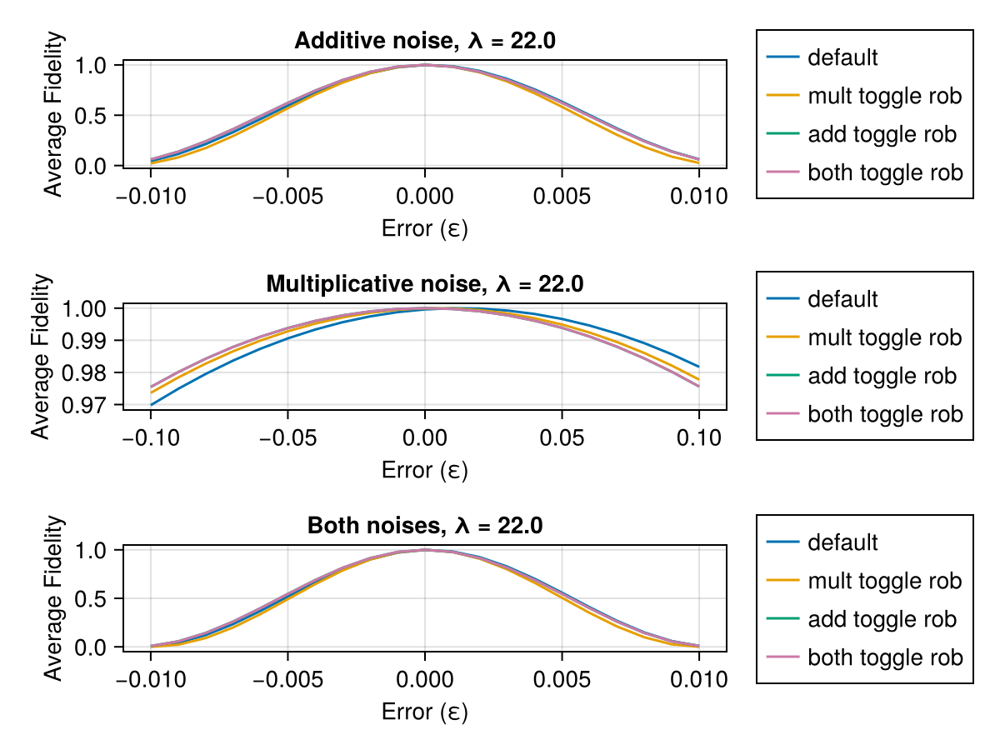

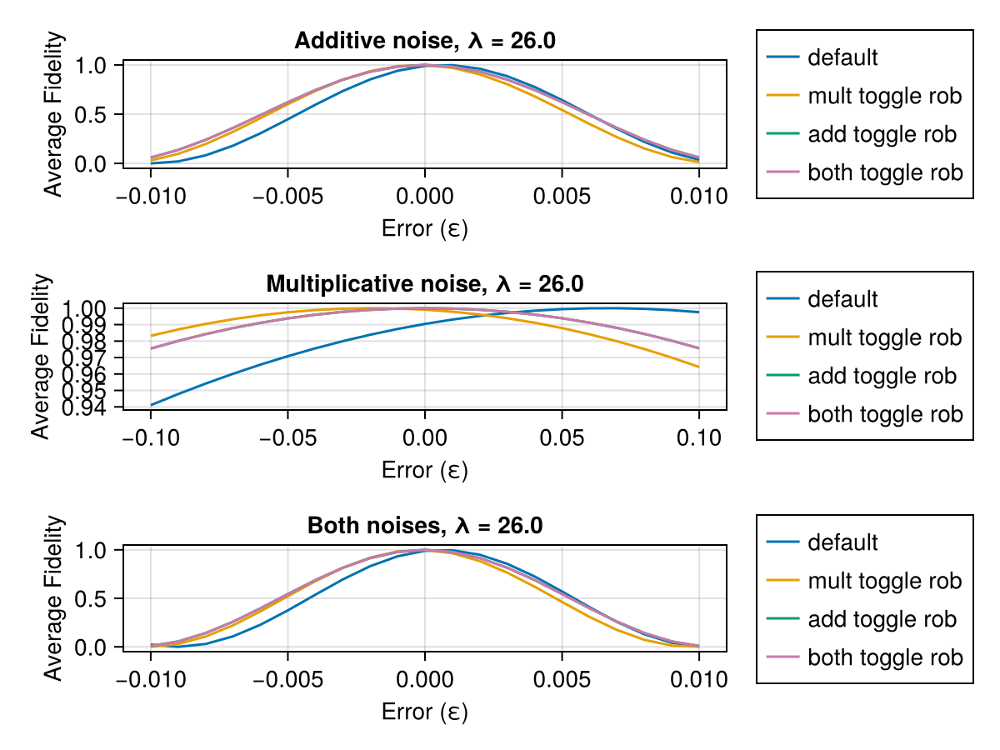

...

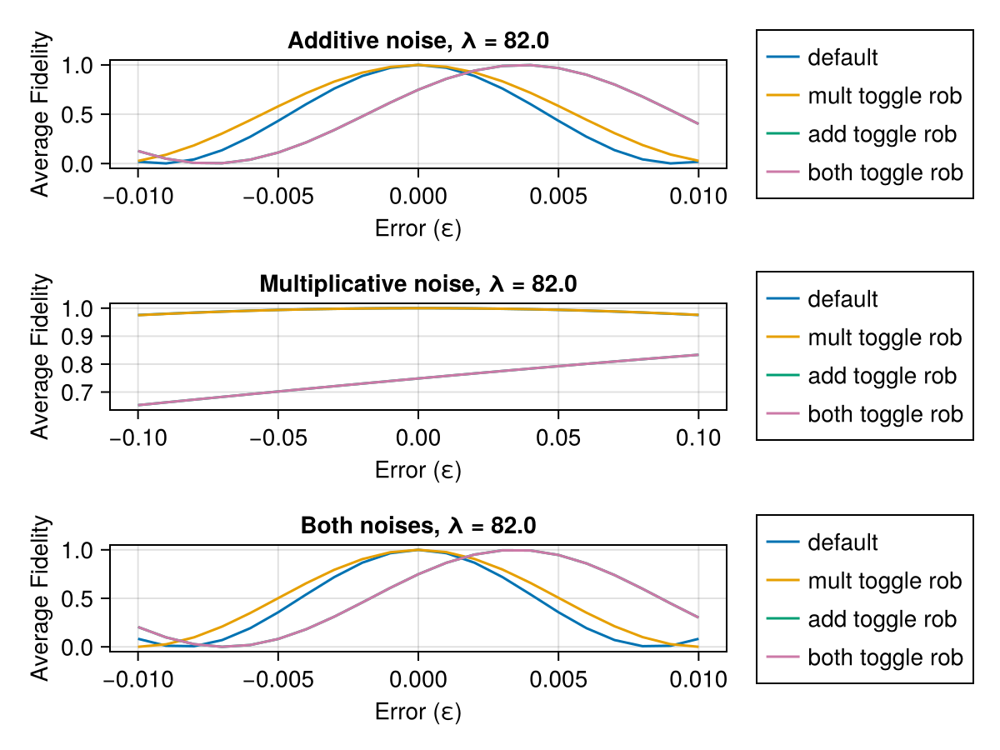

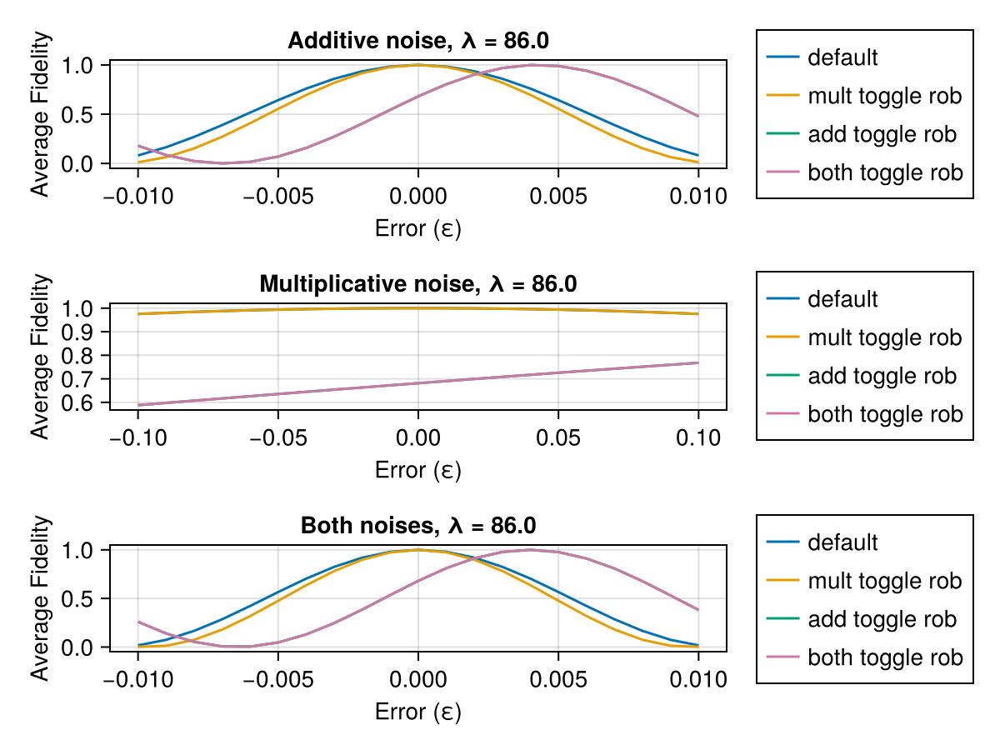

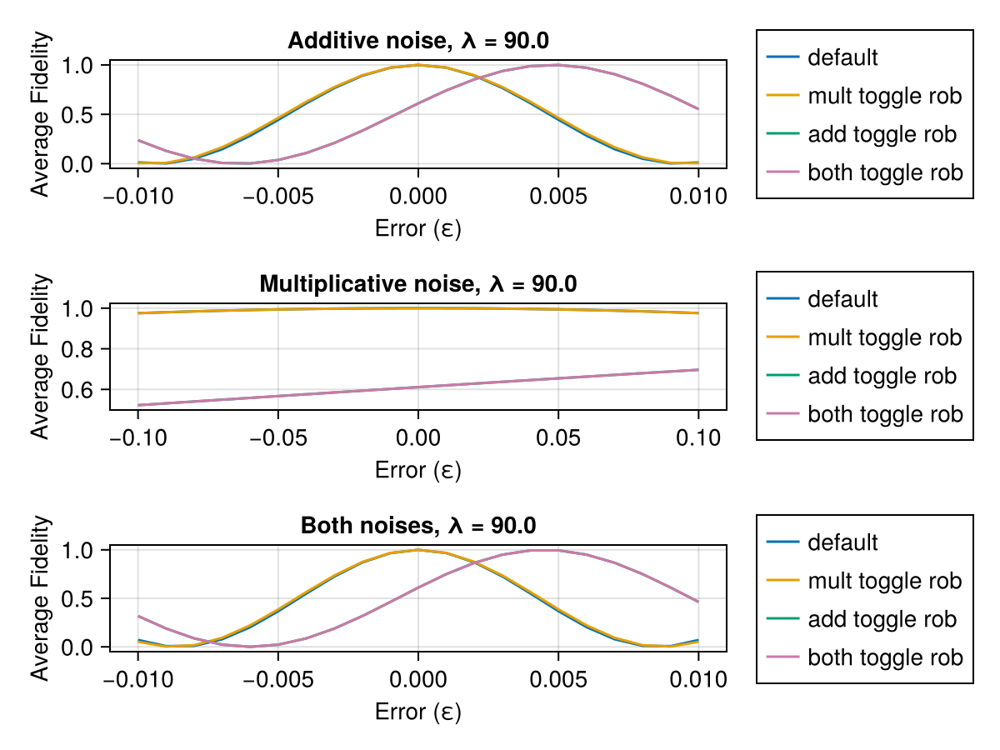

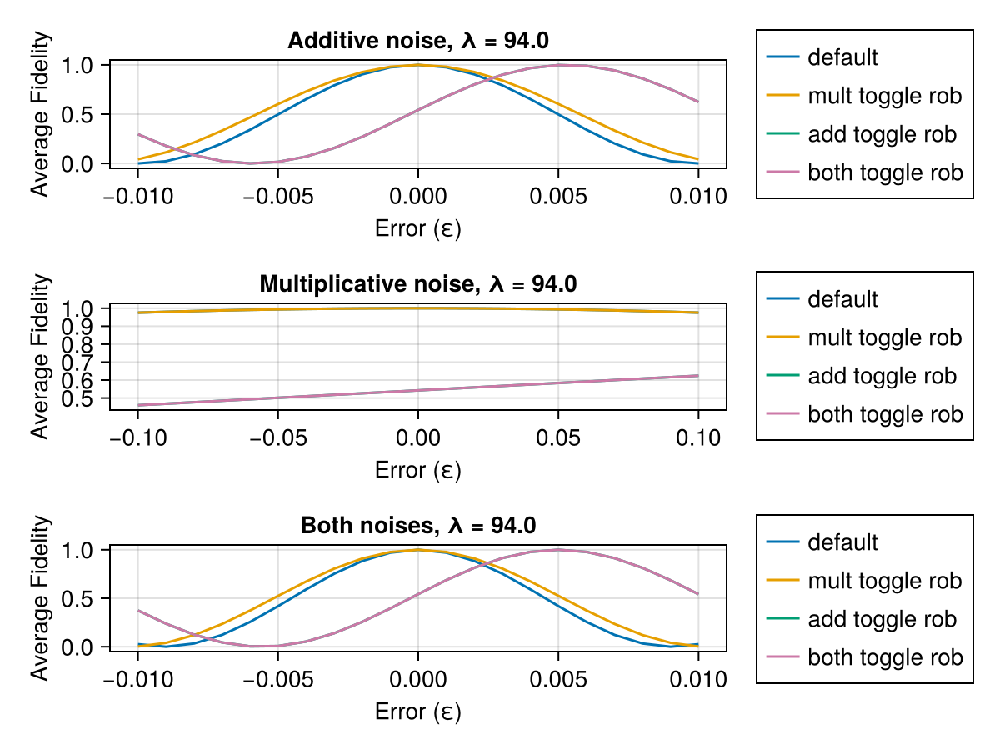

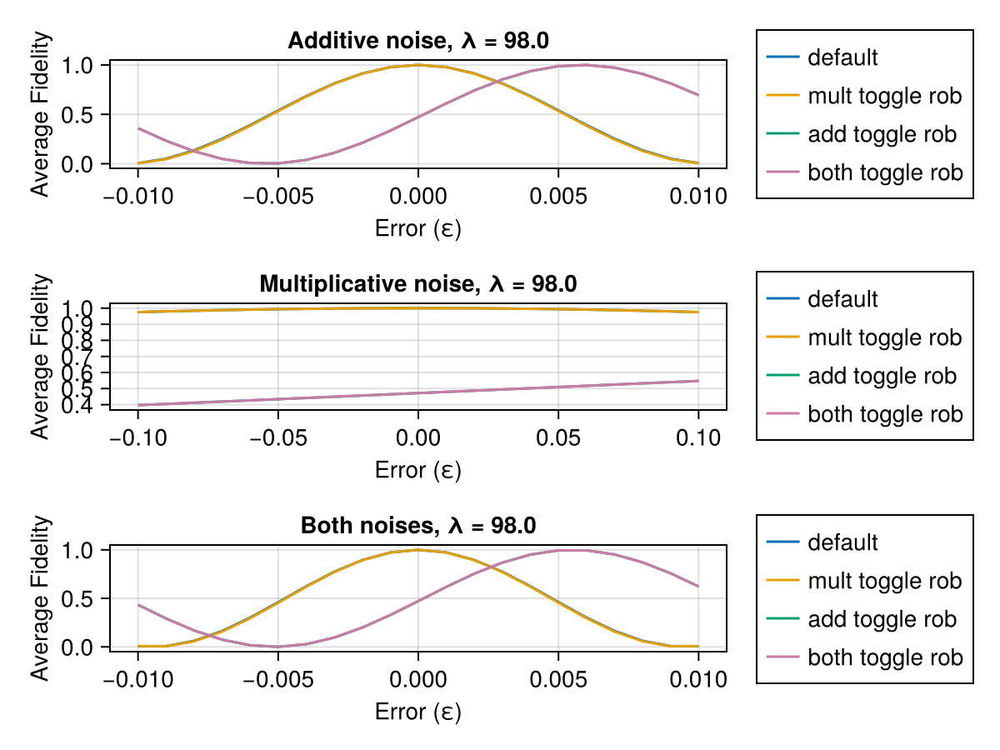

In [39]:
H_drive_add = H_drive
εs = -0.1:0.01:0.1
colors = Makie.wong_colors()

# Plot for each λ
for seed_idx in 1:n_seeds
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        println("\nProcessing λ = $λ")
        f = Figure()
        ax1 = Axis(f[1, 1], title="Additive noise, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")
        ax2 = Axis(f[2, 1], title="Multiplicative noise, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")
        ax3 = Axis(f[3, 1], title="Both noises, λ = $λ", xlabel="Error (ε)", ylabel="Average Fidelity")

        # Define system functions for additive and multiplicative noise
        additive_system = ε -> QuantumSystem(ε * PAULIS.X, [H_drive_add])
        multiplicative_system = ε -> QuantumSystem([(1 + ε) * H_drive])
        both_system = ε -> QuantumSystem(ε * PAULIS.X, [(1 + ε) * H_drive])
        # Plot data structure: (matrix, label, color)
        plot_configs = [
            (tog_defaults, "default", colors[1]),
            (add_tog_probs, "mult toggle rob", colors[2]),
            (mult_tog_probs, "add toggle rob", colors[3]),
            (both_tog_probs, "both toggle rob", colors[4])
        ]

        # Plot for both noise types
        for (probs_matrix, label, color) in plot_configs
            # Additive noise
            prob = probs_matrix[seed_idx, λ_idx]
            ys_add = [unitary_rollout_fidelity(prob.trajectory, QuantumSystem(ε * PAULIS.X, [H_drive_add])) for ε in εs]#0:0.001:0.01]
            lines!(ax1, 0.1*εs, ys_add, label=label, color=color, linestyle=:solid)
            
            # Multiplicative noise
            ys_mult = [unitary_rollout_fidelity(prob.trajectory, QuantumSystem([(1 + ε) * H_drive])) for ε in εs]
            lines!(ax2, εs, ys_mult, label=label, color=color, linestyle=:solid)
            
            # Both noises
            ys_both = [unitary_rollout_fidelity(prob.trajectory, QuantumSystem(ε * PAULIS.X, [(1 + ε) * H_drive])) for ε in εs]#0:0.001:0.01]
            lines!(ax3, 0.1*εs, ys_both, label=label, color=color, linestyle=:solid)
        end

        Legend(f[1, 2], ax1, position=:lb)
        Legend(f[2, 2], ax2, position=:lb)
        Legend(f[3, 2], ax3, position=:lb)

        display(f)
    end
end


In [33]:
Ũ⃗, Ũ⃗_vars = variational_unitary_rollout(add_prob.trajectory, varsys_mult);
QuantumObjectives.unitary_fidelity_loss(Ũ⃗[:, end], GATES.X) |> println

# Detailed results table
display("\n=== Detailed Results Table ===")
for seed_idx in 1:n_seeds
    display("\nseed idx = $seed_idx:")
    display("Weight λ | Base Fidelity | Add Fidelity | Mult Fidelity | Both")
    display("-" ^ 40)
    for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
        def_fid = unitary_rollout_fidelity(tog_defaults[seed_idx, λ_idx].trajectory, sys)
        add_fid = unitary_rollout_fidelity(add_tog_probs[seed_idx, λ_idx].trajectory, varsys_add)
        mult_fid = unitary_rollout_fidelity(mult_tog_probs[seed_idx, λ_idx].trajectory, varsys_mult)
        both_fid = unitary_rollout_fidelity(both_tog_probs[seed_idx, λ_idx].trajectory, varsys_both)
        display("$(lpad(round(λ, digits=4), 7)) | $(lpad(round(def_fid, digits=6), 12)) | $(lpad(round(add_fid, digits=6), 12)) | $(lpad(round(mult_fid, digits=6), 13)) | $(lpad(round(both_fid, digits=6), 12)) |")
    end
end


"\n=== Detailed Results Table ==="

"\nseed idx = 1:"

"Weight λ | Base Fidelity | Add Fidelity | Mult Fidelity | Both"

"----------------------------------------"

"   10.0 |          1.0 |     0.999999 |           1.0 |          1.0 |"

"   14.0 |     0.999996 |          1.0 |           1.0 |          1.0 |"

"   18.0 |      0.99997 |     0.999985 |           1.0 |          1.0 |"

"   22.0 |     0.999619 |     0.999956 |           1.0 |          1.0 |"

"   26.0 |     0.990442 |     0.999089 |           1.0 |          1.0 |"

"   30.0 |          1.0 |          1.0 |           1.0 |          1.0 |"

"   34.0 |          1.0 |          1.0 |      0.999966 |     0.999966 |"

"   38.0 |          1.0 |          1.0 |       0.99989 |      0.99989 |"

"   42.0 |          1.0 |          1.0 |      0.997412 |     0.997412 |"

"   46.0 |          1.0 |          1.0 |      0.994833 |     0.994833 |"

"   50.0 |          1.0 |          1.0 |      0.990016 |     0.990016 |"

"   54.0 |          1.0 |          1.0 |      0.981285 |     0.981285 |"

"   58.0 |          1.0 |          1.0 |      0.967046 |     0.967046 |"

"   62.0 |          1.0 |          1.0 |      0.944814 |     0.944814 |"

"   66.0 |          1.0 |          1.0 |      0.912503 |     0.912503 |"

"   70.0 |          1.0 |     0.999998 |      0.868831 |     0.868831 |"

"   74.0 |          1.0 |          1.0 |      0.813491 |     0.813491 |"

"   78.0 |     0.999999 |          1.0 |      0.808585 |     0.808585 |"

"   82.0 |          1.0 |     0.999997 |      0.748726 |     0.748726 |"

"   86.0 |          1.0 |          1.0 |       0.68148 |      0.68148 |"

"   90.0 |          1.0 |          1.0 |      0.611098 |     0.611098 |"

"   94.0 |          1.0 |          1.0 |      0.542786 |     0.542786 |"

"   98.0 |          1.0 |          1.0 |      0.471904 |     0.471904 |"

#TODO: add plots of trajectories

## Sensitivity Plots

### Robust (w/o adjoint)

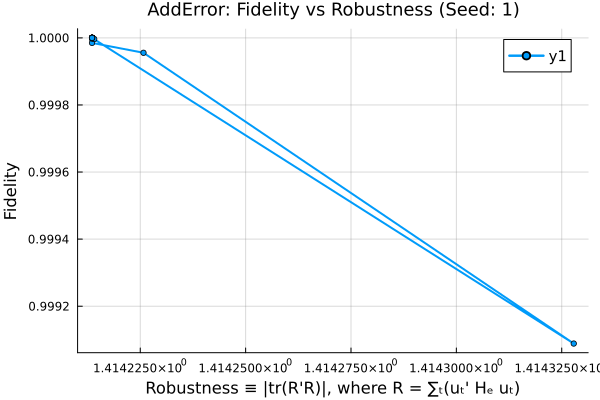

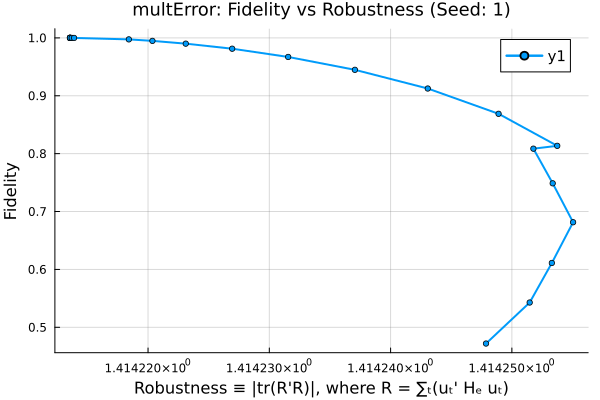

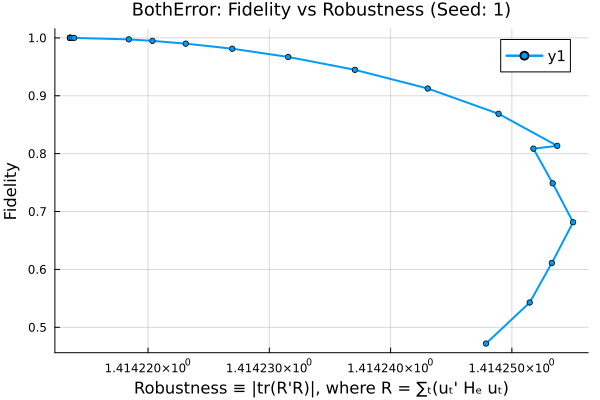

In [36]:
# using Plots
# Initialize storage for fidelities for each lambda
n_lambdas = length(sweep_rob_loss_λ)
n_seeds = length(a_guess)
templates = [add_tog_probs, mult_tog_probs, both_tog_probs]
# Store fidelities for each lambda and error combination


base_fidelities = zeros(n_seeds, n_lambdas)
additive_fidelities = zeros(n_seeds, n_lambdas)
multiplicative_fidelities = zeros(n_seeds, n_lambdas)
both_fidelities = zeros(n_seeds, n_lambdas)
obj_vals = zeros(n_seeds, n_lambdas)


configs = [
            (add_tog_probs, additive_fidelities, varsys_add),
            (mult_tog_probs, multiplicative_fidelities, varsys_mult),
            (both_tog_probs, both_fidelities, varsys_both)
        ]
title_idx = 1
titles = ["Add", "mult", "Both"]

for (probs, fidelities, system) in configs
    println("----------------!New noise model!----------------")
    # Calculate fidelities for each seed
    for seed_idx in 1:n_seeds
        # Calculate fidelities for each lambda
        for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
            
            prob = probs[seed_idx, λ_idx]
            println("\nProcessing λ = $λ")
            obj = QuantumObjectives.FirstOrderObjective(Hₑ, prob.trajectory, [T]; Q_t=λ)#prob.trajectory.Ũ⃗ᵥ1[:, end]
            Z_vec = vec(prob.trajectory)
            obj_val = obj.L(Z_vec)/λ
            obj_vals[seed_idx, λ_idx] = obj_val
            
            rob_fid = unitary_rollout_fidelity(prob.trajectory, system)
            fidelities[seed_idx, λ_idx] = rob_fid
        end
        title_name = titles[title_idx]
        p1 = Plots.plot(xlabel="Robustness ≡ |tr(R'R)|, where R = ∑ₜ(uₜ' Hₑ uₜ)", 
                ylabel="Fidelity",
                title=title_name*"Error: Fidelity vs Robustness (Seed: $seed_idx)",
                legendfontsize=10, titlefontsize=12,
                grid=true, gridwidth=1, gridcolor=:gray, gridalpha=0.3,
                legend=:topright)

            
        Plots.plot!(p1, obj_vals[seed_idx, :], fidelities[seed_idx, :],
            marker=:circle, markersize=3, linewidth=2)


        # Display all plots
        display(p1)
    end
    title_idx += 1
end

# # Detailed results table
# println("\n=== Detailed Results Table ===")
# for seed_idx in 1:n_seeds
#     println("\nseed idx = $seed_idx:")
#     println("Weight λ | Base Fidelity | Add Fidelity | Mult Fidelity | Both")
#     println("-" ^ 40)
#     for (λ_idx, λ) in enumerate(sweep_rob_loss_λ)
#         println("$(lpad(round(λ, digits=4), 7)) | $(lpad(round(base_fidelities[seed_idx, λ_idx], digits=6), 12)) | $(lpad(round(additive_fidelities[seed_idx, λ_idx], digits=6), 12)) | $(lpad(round(multiplicative_fidelities[seed_idx, λ_idx], digits=6), 13)) | $(lpad(round(both_fidelities[seed_idx, λ_idx], digits=6), 12)) |")
#     end
# end
